In [1]:
import geopandas as gpd
import pandas as pd
import numpy as np

We'll need the packages above to start visualizing maps.

If you choose to use other packages specific to GIS and cartography like Folium - you may use that as well.

In the cell below, we're going to be read the geojson file for counties boundaries.

In [2]:
county_bounds = gpd.read_file('C:\\Users\\ldmag\\Documents\\GitHub\\Tutorials-COVID-19\\tutorials-fall-2022\\GeoSpatial_MappingTutorial\\us-county-boundaries.geojson')

In [4]:
county_bounds.columns

Index(['geo_point_2d', 'statefp', 'countyfp', 'countyns', 'geoid', 'name',
       'namelsad', 'stusab', 'lsad', 'classfp', 'mtfcc', 'csafp', 'cbsafp',
       'metdivfp', 'funcstat', 'aland', 'awater', 'intptlat', 'intptlon',
       'state_name', 'countyfp_nozero', 'geometry'],
      dtype='object')

Take some time to look over the geojson file with a text editor, note the file strcuture and features, since you might have to use layers with mapping tools.

Note that you can also use this with a shapefile, but you also need the .shx file in the working directory alongside the .shp file. Aggregations on a GeoPandas dataframe will convert it into a pandas dataframe, which changes the file structure - making it unreadable to a GIS mapper. You will need to make a copy of the variable you store the file in to make mapping workable. 

To plot a map from the geojson data, you can use the the ```gpd.plot()``` function. Make sure to key in on the right feature.

<Axes: >

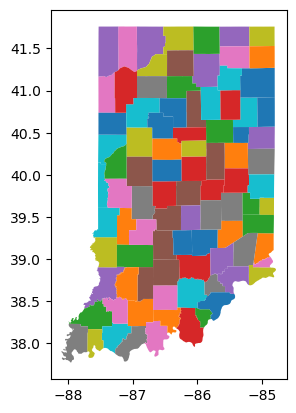

In [5]:
county_bounds.plot('name')

The above map is at a county level. Go ahead and look at the geopandas documentation to change how colours are assigned - since its based on the matplotlib library, you may use the same commands to assign legends, and axis titles.

You can also overlay a map and make this more interactive using the ```.explore()``` command.

In [6]:
county_bounds.explore('name')

Now for tract level information.

This is a bit more difficult to work with, since you have increased the granularity of the subject matter. If you've received the shapefiles Ironhacks has distributed to you via email, you can use https://mapshaper.org to convert the shapefiles and their information into a GEOJSON file. Make sure to import all files into the client, then export them into any designated format you wish to usel in this case - the GEOJSON extension. If your file downloads as a JSON extension, don't worry - they share the same extension. 

If you wish to continue with a shapefile (.SHP) extension, you can still use the ```gpd.read_file()``` command to read files. Be sure to confirm with documentation on usage. 

In [7]:
tract_bounds = gpd.read_file('C:\\Users\\ldmag\\Documents\\GitHub\\Tutorials-COVID-19\\tutorials-fall-2022\\GeoSpatial_MappingTutorial\\tl_2022_18_tract2.json')
tract_bounds.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'GEOID', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry'],
      dtype='object')

This data was derived from two sources, so it is common to find different file structures and feature property names on them.

We can still plot the geometry we have using the previous commands, Again, be sure to key in the right feature.

<Axes: >

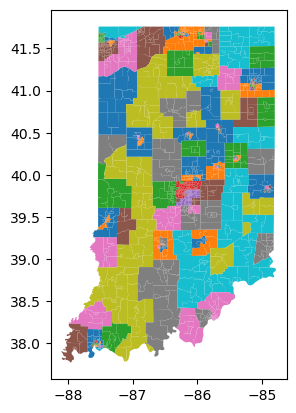

In [8]:
tract_bounds.plot('NAMELSAD')

Note the difference between the two maps.

In [9]:
tract_bounds.explore('NAMELSAD')

When attempting to plot for tracts and counties - make sure to engineer dataframes in a manner that can be read by the mapper class.

For example, the Folium mapper reads GEOJSON files natively - but requires all data such as total cases, and other demographics information to be in a geopandas.dataframe object type. Merging data onto or from a geopandas dataframe makes it a pandas dataframe. So you'll have two options at this point - either engineer your own custom GEOJSON file with the information you need built into it - or use existing functions that overlay a map provided as a different parameter; such as the Folium.Choropleth map function.

You may also overlay a map and plot data on it using teh LayerControl module in Folium, so carefully consider your options and scope. 